# 2021-2 텍스트마이닝 기말 프로젝트

# import packages

In [1]:
import requests
import time
import re
import pandas as pd
import pprint
import pycrfsuite

import eli5

import numpy as np
import matplotlib.pyplot as plt
import math
import seaborn as sns
import site; site.getsitepackages()

from bs4 import BeautifulSoup

from tensorflow.keras.layers import Embedding, Dense, LSTM
from tensorflow.keras.models import Sequential
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

from sklearn.metrics import confusion_matrix, classification_report

from sklearn.naive_bayes import MultinomialNB
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC, LinearSVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import Perceptron
from sklearn.linear_model import SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier

from collections import defaultdict

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences

from sklearn_crfsuite import CRF 
from sklearn.model_selection import cross_val_predict # train_test_split <- 쓰려면 쓰기
from sklearn_crfsuite .metrics import flat_classification_report # metrics: measure(Accuracy, score 등) 도구

from nltk.probability import FreqDist
from pycrfsuite_spacing import TemplateGenerator
from pycrfsuite_spacing import CharacterFeatureTransformer
from pycrfsuite_spacing import sent_to_xy
from bs4 import BeautifulSoup
from konlpy.tag import Kkma as kkm
from konlpy.tag import Okt
import tweepy


# score 정보 -> (원하는 것) 어떤 문장이 몇점인지를 예측 -> 이 값이 평균 이상이면 긍정, 평균 미만이면 부정
#            -> 긍/부정 으로만 학습하면 결과가 더 부정확할 수도. 
#            -> (현행) 평균 이상이면 100, 미만 0으로 분류해서 학습, 적용

# kkm 형태소 분석기에서 사전 조정해서, 칼퇴, 워라밸 같은 우리가 사용하는 단어로 수정하기.
# raw data : 맞춤법 교정.
# 조사 같은 연결어 제외하기. feature 추가(전전단어와 후후단어)
# CRF : N-gram ?????  kkm 사전을 형태소로 나눠놓고 하는 걸로. 

# 긍정/부정 리뷰 스크래핑+키워드 추출+사전으로 추가(feature) 
# 명사(를 비롯한 주요 단어)인 pos tag 만 뽑아서 feature에서 가중치 주기. 
# feature: pos tag에서 규칙 찾아서(eg. NNG+NNG) 여러 단어 연접하여 새롭게 긍/부정어 사전 돌리기 ??? <- 복잡. 
# 쪼개진 긍부정어 사전(만들어진 txt) 찾아보기.

# 조사 없애기? pos tag 포기. 띄어쓰기 교정 + 맞춤법 교정 + CRF ...? 
# feat -1, +1 < 최고로 나쁘다 -> 최고 로 나쁘 다 : 이런 식으로 CRF 특징이 무효화 됨.  

# CRF가 아니라, 다른 방식으로 해보는 게 어떤지? eg. review classification처럼 
# summarization + 빈도수 처리 + .... + N-gram 활용
# 시각화: eli5 

# Web Scraping

In [2]:
# 참고 사이트 https://yeo0.github.io/data/2018/09/24/5.-%EB%A1%9C%EA%B7%B8%EC%9D%B8%EC%9D%B4-%ED%95%84%EC%9A%94%ED%95%9C-%EC%82%AC%EC%9D%B4%ED%8A%B8%EC%97%90%EC%84%9C%EC%9D%98-%ED%81%AC%EB%A1%A4%EB%A7%81/
# 참고 사이트 2 https://hashcode.co.kr/questions/9084/%EC%9E%A1%ED%94%8C%EB%9E%98%EB%8B%9B-%EB%A1%9C%EA%B7%B8%EC%9D%B8-%ED%9B%84-%EC%8A%A4%ED%81%AC%EB%A0%88%EC%9D%B4%ED%95%91-%EB%AC%B8%EC%9D%98%EB%93%9C%EB%A6%BD%EB%8B%88%EB%8B%A4-%E3%85%9C%E3%85%9C

# 로그인 할 url
url = "https://www.jobplanet.co.kr/users/sign_in?_nav=gb"
user_agent = 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/78.0.3904.97 Safari/537.36'
headers = {'Content-type': 'application/json', 'Accept': 'text/plain', 'User-Agent':user_agent}
login_data = {'user':{'email':'hsmy31@hanyang.ac.kr', 'password':'rhkwpgksmswnd!', 'remember_me':'true'}}
session = requests.session()

# 로그인 실행
login_response = session.post(url, json = login_data, headers = headers)

reviews = []

In [3]:
#전체 리뷰 추출

def all_reviews(code):
    url = "https://www.jobplanet.co.kr/reviews?&industry_id=" + str(code)
    response =  session.get(url)
    soup = BeautifulSoup(response.text, 'html.parser')
    num = soup.find('span', class_='num') # 리뷰 개수 확인
    num = int(num.get_text().strip())
    import math, random
    pages = math.ceil(num / 10)
    reviews = {}
    for i in range(pages+1):
        time.sleep(1)
        url = "https://www.jobplanet.co.kr/reviews?&industry_id=" + str(code) + "&page="+ str(i)
        response =  session.get(url)
        soup = BeautifulSoup(response.text, 'html.parser')
        label = soup.find_all('h2', class_="us_label") # 한 줄 리뷰 추출
        # 추출한 리뷰에서 태그를 제외한 텍스트만 추출하여 labels 리스트에 저장
        labels = [label.get_text().strip() for label in label[:]]
        star = soup.find_all('div', class_="star_score") # 별점이 포함된 div 추출
        # 추출한 div에서 별점을 나타내는 width 속성의 숫자로 된 부분을 stars 리스트에 저장
        stars = re.findall('[0-9]+[.]+[0-9]', str(star))
        # reviews 딕셔너리에 '리뷰: 별점' 형식으로 추가
        for j in range(len(labels)):
            reviews[labels[j][5:-1]] = stars[j].replace('.0','')
    return reviews

In [4]:
#전체 리뷰 및 별점 딕셔너리화
codes = ['1001', '900', '704', '1004']
reviews={}

for i in range(0,len(codes)):
    reviews.update(dict(all_reviews(codes[i])))

In [5]:
len(reviews)

2552

In [6]:
# 리스트 형식으로 text와 score 각각 저장
text_all=list(reviews.keys())
score_all=list(reviews.values())

In [7]:
print(len(text_all))
score_all[:10]

2552


['100', '100', '96', '96', '94', '94', '94', '94', '94', '94']

In [8]:
# 전체 리뷰의 평균값 구하기
sum=0
for i in range(len(score_all)):
    sum+=int(score_all[i])
avr_all=sum/len(score_all)
print("score 평균값: ", round(avr_all,3))

score 평균값:  56.194


# 긍정어/부정어사전 만들기

In [9]:
#공통/ 업종별 불용어(자주 나오지만 문서 전체에 관련되어 있어 성능 체크에 의미가 없는 단어들) 선언
stopwords=['있음','기업', '업무', '회사', '직장','분위기','사람','직원','근무']

In [10]:
#긍/부정 리뷰별 빈출단어 추출 및 사전화
#검색 성능을 높이기 위해 문장을 제일 잘게 쪼개는 kkma 사용

kkm=kkm()

text_kkm=[]

#형태소 분석 및 문장별 점수 매칭

for i in range(len(text_all)):
    text_kkm.append(kkm.nouns(text_all[i]))
    text_kkm[i].append(score_all[i])
    
print(text_kkm[:10])

[['대체적', '근무', '환경', '부서', '업무량', '시', '야근', '필요', '경우', '존재', '100'], ['정년', '보장', '도서', '도서대출반납', '대출', '반납', '다양', '프로그램', '운영', '운영중', '중', '100'], ['대한', '대한민국', '민국', '식량', '식량산업', '산업', '최전선', '분투', '해군', '소수', '소수정예', '정예', '종자', '종자관리', '관리', '전문', '전문기관', '기관', '소속', '소속직원', '직원', '대한민국전체', '전체', '200', '200명', '명', '96'], ['수평적', '회사', '회사분위기', '분위기', '상사', '눈치', '안', '안보고', '보고', '휴가', '내가', '일', '외국인', '사람', '저녁', '삶', '가능', '직장', '96'], ['민원인', '업무', '업무강도', '강도', '조사관', '친절', '94'], ['세종', '세종시', '시', '활동', '기업', '기업지원기관', '지원', '기관', '신생', '신생기관', '94'], ['도청', '근무', '충청남', '충청남도', '도', '총괄적', '업무', '수행', '예하', '시', '시군의', '군의', '정책', '그림', '곳', '94'], ['서울', '도심', '국제기구', '국제', '국제현안', '현안', '수', '관련', '커리어', '있음', '94'], ['자유', '분위기', '보수적', '공공', '공공기관', '기관', '생각', '때', '느낌', '유사', '94'], ['노동법', '곳', '직원', '전반적', '함', '악성', '민', '민원인', '원인', '상대', '가나', '있음', '94']]


In [11]:
pos_kkm=[]
morphs_kkm=[]
dic_stopwords=stopwords
#연관이 낮아 보이는 형태소와 1글자 음절, 불용어를 제외한 체언, 용언, 관형사, 부사만 뽑아내기

for i in range(len(text_all)):
    pos_kkm.append(kkm.pos(text_all[i]))

dic_kkm=[]

for i in range(len(pos_kkm)):
    dic_kkm.append([])
    for j in range(len(pos_kkm[i])):
        if pos_kkm[i][j][0] not in dic_stopwords:
            if pos_kkm[i][j][1].startswith('N') or pos_kkm[i][j][1].startswith('V')or pos_kkm[i][j][1].startswith('M'):
                dic_kkm[i].append(pos_kkm[i][j][0])
    dic_kkm[i].append(int(score_all[i]))


In [12]:
dic_kkm[:10]

[['대체적',
  '환경',
  '좋',
  '부서',
  '따르',
  '다르',
  '업무량',
  '몰리',
  '시',
  '야근',
  '필요',
  '경우',
  '존재',
  100],
 ['정년',
  '확실히',
  '보장',
  '도서',
  '대출',
  '반납',
  '아니',
  '다양',
  '프로그램',
  '운영',
  '중',
  '이',
  '좋',
  100],
 ['대한민국',
  '식량',
  '산업',
  '최전선',
  '분투',
  '해군',
  '같',
  '소수',
  '정예',
  '종자',
  '관리',
  '전문',
  '기관',
  '소속',
  '대한민국',
  '전체',
  '200',
  '명',
  '없',
  96],
 ['수평적',
  '이',
  '좋',
  '상사',
  '눈치',
  '많이',
  '안',
  '보고',
  '휴가',
  '쓰',
  '내가',
  '하',
  '일',
  '열심히',
  '하',
  '되',
  '외국인',
  '일하',
  '것',
  '좋아하',
  '즐기',
  '저녁',
  '있',
  '삶',
  '가능',
  96],
 ['민원인', '많', '강도', '높', '조사관', '친절', 94],
 ['세종', '시', '활동', '좋', '지원', '기관', '이', '신생', '기관', '이', 94],
 ['도청',
  '충청남도',
  '관하',
  '총괄적',
  '이',
  '수행',
  '되',
  '예하',
  '시',
  '군의',
  '정책',
  '크',
  '그림',
  '그리',
  '곳',
  94],
 ['서울',
  '도심',
  '있',
  '국제기구',
  '국제',
  '현안',
  '다루',
  '수',
  '있',
  '관련',
  '커리어',
  '쌓',
  '수',
  94],
 ['자유', '보수적', '이', '않', '상당히', '공공', '기관', '생각', '때', '느낌', '가장', '유사', 9

In [13]:
# 긍/부정 빈도수 체크하여 상위 100개를 사전으로 저장

dic_text_pos=[]
dic_text_neg=[]  

for i in range(len(dic_kkm)):
    for j in range(0, len(dic_kkm[i])):
        if type(dic_kkm[i][j]) != int:
            if len(dic_kkm[i][j])>1:
                if float(dic_kkm[i][ -1]) > avr_all:
                    dic_text_pos.append(dic_kkm[i][j])
                else:
                    dic_text_neg.append(dic_kkm[i][j])

fdist1=FreqDist(dic_text_pos)
dic_text_pos=fdist1.most_common(100)

fdist1=FreqDist(dic_text_neg)
dic_text_neg=fdist1.most_common(100)

In [14]:
dic_text_pos1=[]
dic_text_neg1=[]

for i in range(len(dic_text_pos)):
    dic_text_pos1.append(dic_text_pos[i][0])
    
for i in range(len(dic_text_neg)):
    dic_text_neg1.append(dic_text_neg[i][0])

print(dic_text_pos1)
print(dic_text_neg1)

['일하', '다니', '경험', '다양', '배우', '문화', '복지', '기관', '환경', '생각', '가지', '성장', '편하', '추천', '연봉', '대하', '안정적', '많이', '아니', '가능', '공무원', '공공', '최고', '발전', '계약', '조직', '자유', '급여', '괜찮', '대우', '공기업', '강도', '나쁘', '매우', '업계', '여러', '시간', '힘들', '하지만', '사업', '보장', '수평적', '따르', '개발', '본인', '경력', '금융', '부서', '없이', '자기', '비하', '노력', '생활', '너무', '장점', '투자', '커리어', '사회', '위하', '신입', '은행', '다르', '보수적', '그냥', '함께', '정도', '다른', '수준', '기회', '만족', '보이', '능력', '성과', '만큼', '전반적', '체계', '월급', '외국계', '야근', '이상', '느끼', '때문', '개인', '사내', '운영', '지원', '다만', '하나', '가능성', '규모', '인턴', '정규직', '빠르', '눈치', '느낌', '지역', '그러', '한국', '안정성', '관심']
['일하', '다니', '배우', '추천', '생각', '문화', '다양', '복지', '힘들', '너무', '기관', '경력', '아니', '경험', '연봉', '많이', '신입', '대하', '체계', '급여', '사무실', '괜찮', '그냥', '자유', '나쁘', '대표', '환경', '발전', '성장', '매우', '편하', '위하', '모르', '못하', '개인', '시간', '다르', '따르', '가지', '안정적', '바뀌', '가능', '이상', '야근', '별로', '사업', '업계', '입사', '공공', '계약', '운영', '보험', '회계', '최악', '금융', '보수적', '본인', '조직', '오래', '자기', '하나', '대우', '은행', '퇴사',

# 데이터 전처리

In [15]:
sent_num=0
text_sent=[]

for i in range(len(text_all)):
    text_pos=kkm.pos(text_all[i])
    sent_num+=1
    for t in text_pos:
        n=list(t)
        n.insert(0, "Sentence: {}".format(sent_num))
        if float(score_all[(sent_num-1)]) > avr_all:
            n.insert(3, '100')
        else: 
            n.insert(3, '0')        
        text_sent.append(n)

In [16]:
len(text_sent)

63175

In [17]:
# 불용어 처리 전 token 빈도 수 확인
words=[]
for t in text_sent :
    words.append(t[1])

In [18]:
# 단어 사전 만들기 (key : value = word : 빈도 수)
words_dict = {} # 
for word in words:
    if word in words_dict:
        words_dict[word] += 1
    else:
        words_dict[word] = 1

In [19]:
sort_dict = sorted(words_dict.items(), key=lambda x: x[1], reverse=True)    

In [20]:
pprint.pprint(sort_dict)

[('하', 2552),
 ('이', 2453),
 ('는', 2050),
 ('.', 1793),
 ('ㄴ', 1659),
 ('은', 1259),
 ('고', 1169),
 ('있', 1048),
 ('ㄹ', 979),
 ('을', 971),
 ('가', 871),
 ('회사', 777),
 ('에', 737),
 ('좋', 694),
 ('수', 693),
 (',', 649),
 ('어', 602),
 ('들', 567),
 ('의', 561),
 ('곳', 555),
 ('다', 528),
 ('음', 495),
 ('ㅁ', 459),
 ('도', 457),
 ('지', 452),
 ('를', 432),
 ('으로', 425),
 ('업무', 390),
 ('없', 373),
 ('사람', 364),
 ('되', 347),
 ('게', 346),
 ('기', 336),
 ('않', 321),
 ('많', 313),
 ('일', 306),
 ('것', 304),
 ('었', 301),
 ('ㅂ니다', 287),
 ('지만', 280),
 ('일하', 270),
 ('분위기', 262),
 ('에서', 260),
 ('과', 254),
 ('면', 252),
 ('기업', 243),
 ('직원', 238),
 ('로', 230),
 ('만', 228),
 ('다니', 218),
 ('아', 215),
 ('습니다', 196),
 ('있음', 190),
 ('배우', 173),
 ('보', 165),
 ('며', 163),
 ('나', 153),
 ('경험', 153),
 ('근무', 151),
 ('다양', 148),
 ('문화', 146),
 ('생각', 144),
 ('싶', 143),
 ('추천', 142),
 ('같', 135),
 ('복지', 134),
 ('라', 131),
 ('어서', 130),
 ('주', 129),
 ('기관', 128),
 ('와', 128),
 ('에게', 128),
 ('잘', 125),
 ('으나', 124),
 

 ('난무', 4),
 ('올리', 4),
 ('나이스', 4),
 ('자율', 4),
 ('스킬', 4),
 ('조', 4),
 ('의사소통', 4),
 ('&', 4),
 ('노조', 4),
 ('판', 4),
 ('시중', 4),
 ('예상', 4),
 ('통화', 4),
 ('속도', 4),
 ('비용', 4),
 ('은행권', 4),
 ('급성장', 4),
 ('중요시', 4),
 ('카드', 4),
 ('오너', 4),
 ('옆', 4),
 ('회장', 4),
 ('독립', 4),
 ('블', 4),
 ('그저', 4),
 ('느림', 4),
 ('순', 4),
 ('금고', 4),
 ('이러', 4),
 ('터', 4),
 ('효율', 4),
 ('가져가', 4),
 ('엑셀', 4),
 ('근', 4),
 ('롯데', 4),
 ('A', 4),
 ('각자', 4),
 ('대리점', 4),
 ('수직', 4),
 ('간섭', 4),
 ('마지막', 4),
 ('술', 4),
 ('기분', 4),
 ('00', 4),
 ('신고', 4),
 ('엔지니어', 4),
 ('폰', 4),
 ('별도', 4),
 ('실장', 4),
 ('정예', 3),
 ('전체', 3),
 ('즐기', 3),
 ('저녁', 3),
 ('민원인', 3),
 ('연가', 3),
 ('수가', 3),
 ('정착', 3),
 ('후회', 3),
 ('적정', 3),
 ('추세', 3),
 ('강남', 3),
 ('핵심', 3),
 ('매너', 3),
 ('관공서', 3),
 ('불구', 3),
 ('내일', 3),
 ('공관', 3),
 ('제가', 3),
 ('근로자', 3),
 ('정확', 3),
 ('일도', 3),
 ('카페', 3),
 ('박사', 3),
 ('졸업', 3),
 ('석사', 3),
 ('90', 3),
 ('직군', 3),
 ('각종', 3),
 ('정신적', 3),
 ('직장인', 3),
 ('선거', 3),
 ('안정감', 3),
 ('여건', 3)

 ('가정과', 1),
 ('수목원', 1),
 ('띄', 1),
 ('But', 1),
 ('농촌', 1),
 ('경찰서', 1),
 ('넘어오', 1),
 ('게이트', 1),
 ('투', 1),
 ('톱', 1),
 ('전입', 1),
 ('다가오', 1),
 ('탈출', 1),
 ('청사', 1),
 ('조직성', 1),
 ('타지역', 1),
 ('소문', 1),
 ('대외적', 1),
 ('역사가', 1),
 ('한명', 1),
 ('궁리', 1),
 ('동등', 1),
 ('심해', 1),
 ('강동구', 1),
 ('독려', 1),
 ('일종', 1),
 ('경쟁률', 1),
 ('다치', 1),
 ('변두리', 1),
 ('노원구', 1),
 ('합리성', 1),
 ('껍데기', 1),
 ('미술관', 1),
 ('관람객', 1),
 ('스탭', 1),
 ('총괄', 1),
 ('팍팍', 1),
 ('ㅂ니까', 1),
 ('ㅁ다만', 1),
 ('일반직', 1),
 ('체육회', 1),
 ('못받는', 1),
 ('무르', 1),
 ('창작', 1),
 ('공연', 1),
 ('진로', 1),
 ('대잔치', 1),
 ('일상인', 1),
 ('타군', 1),
 ('제각각', 1),
 ('핫', 1),
 ('OK', 1),
 ('예술가', 1),
 ('않는', 1),
 ('볼', 1),
 ('직영', 1),
 ('통일', 1),
 ('허울', 1),
 ('장이', 1),
 ('찍', 1),
 ('ㅍ', 1),
 ('불행', 1),
 ('전채', 1),
 ('안일', 1),
 ('대답', 1),
 ('재료', 1),
 ('두고', 1),
 ('교과', 1),
 ('레크리에이션', 1),
 ('기독', 1),
 ('회계과', 1),
 ('출신자', 1),
 ('강당', 1),
 ('마이크', 1),
 ('소생', 1),
 ('통제하', 1),
 ('용산구', 1),
 ('관내', 1),
 ('어린이집', 1),
 ('장난감', 1),
 ('서관',

 ('넵', 1),
 ('봇', 1),
 ('돔', 1),
 ('챠', 1),
 ('자격', 1),
 ('입력', 1),
 ('뒷전', 1),
 ('형식적', 1),
 ('변동', 1),
 ('현실화하', 1),
 ('시기상조', 1),
 ('기렇', 1),
 ('갈팡질팡', 1),
 ('문어발', 1),
 ('실패', 1),
 ('은행업', 1),
 ('고위', 1),
 ('재물', 1),
 ('배상', 1),
 ('보여', 1),
 ('안쓰럽', 1),
 ('휘청거리', 1),
 ('지에', 1),
 ('이의', 1),
 ('맘대로', 1),
 ('움직임', 1),
 ('옷', 1),
 ('급격', 1),
 ('가중', 1),
 ('멀', 1),
 ('매니저', 1),
 ('복잡', 1),
 ('규칙적', 1),
 ('상장', 1),
 ('............', 1),
 ('감시', 1),
 ('윽', 1),
 ('박', 1),
 ('기싸움', 1),
 ('유지가', 1),
 ('두서없', 1),
 ('중앙회', 1),
 ('쩔', 1),
 ('짓', 1),
 ('문화인', 1),
 ('평사원', 1),
 ('성되', 1),
 ('서울지점', 1),
 ('애착', 1),
 ('임기', 1),
 ('우기', 1),
 ('검', 1),
 ('영달', 1),
 ('선후배', 1),
 ('공해', 1),
 ('렌트카', 1),
 ('화물차', 1),
 ('불꽃', 1),
 ('바로바로', 1),
 ('××', 1),
 ('중개업', 1),
 ('드시', 1),
 ('어르신', 1),
 ('여행자', 1),
 ('시국', 1),
 ('간단히', 1),
 ('피해', 1),
 ('입히', 1),
 ('고가', 1),
 ('수용', 1),
 ('현대자동차', 1),
 ('연령층', 1),
 ('고르', 1),
 ('성비', 1),
 ('우주', 1),
 ('행성', 1),
 ('차원', 1),
 ('불일치', 1),
 ('결정력', 1),
 ('법인체', 1),
 

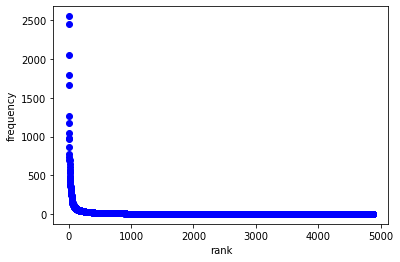

In [21]:
rank=0

for k, v in sort_dict:
    rank+=1
    plt.plot(rank, words_dict[k], 'bo')
plt.xlabel('rank')
plt.ylabel('frequency')
plt.show()

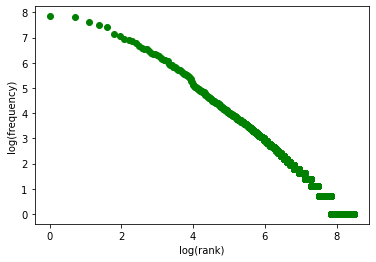

In [22]:
rank=0
for k, v in sort_dict:
    rank+=1
    plt.plot(math.log(rank), math.log(v), 'go')
plt.xlabel('log(rank)')
plt.ylabel('log(frequency)')
plt.show()

In [23]:
text_del_SW = [] # POS(조사, 특수문자, 접사) 제거

for t in text_sent : 
    if ( (t[2][0] !='E') & (t[2][0] !='J') & (t[2][0] !='S') ):
        text_del_SW.append(t)

In [24]:
# (수동)불용어 사전 만들기
stopwords2=['하', '수', '있', '이','것', '되', '등', '적', '들', '성', '일', '보', '롭', '주']
text_del_SW2 = []
for t in text_del_SW: 
    if t[1] not in stopwords2:
        text_del_SW2.append(t)

In [25]:
text_del_SW2[:10]

[['Sentence: 1', '대체적', 'NNG', '100'],
 ['Sentence: 1', '근무', 'NNG', '100'],
 ['Sentence: 1', '환경', 'NNG', '100'],
 ['Sentence: 1', '좋', 'VA', '100'],
 ['Sentence: 1', '부서', 'NNG', '100'],
 ['Sentence: 1', '따르', 'VV', '100'],
 ['Sentence: 1', '다르', 'VV', '100'],
 ['Sentence: 1', '업무량', 'NNG', '100'],
 ['Sentence: 1', '몰리', 'VV', '100'],
 ['Sentence: 1', '시', 'NNG', '100']]

In [26]:
len(text_sent) # 불용어 처리 전 token 수

63175

In [27]:
len(text_del_SW2) # 불용어 처리 후 token 수

31041

In [28]:
# dictionary(word: freq) return 함수 만들고 싶은데 실패함
'''
def words_dict(sent_in):
    words=[]
    for t in sent_in :
        words.append(t[1])
        
    words_dict = {}
    for word in words
        if word in words_dict:
            words_dict[word] += 1
        else:
            words_dict[word] = 1
    return words_dict
'''

'\ndef words_dict(sent_in):\n    words=[]\n    for t in sent_in :\n        words.append(t[1])\n        \n    words_dict = {}\n    for word in words\n        if word in words_dict:\n            words_dict[word] += 1\n        else:\n            words_dict[word] = 1\n    return words_dict\n'

In [29]:
words=[]
for t in text_del_SW2 :
    words.append(t[1])
        

In [30]:
# 단어 사전 만들기 (key : value = word : 빈도 수)
words_dict = {} # 
for word in words:
    if word in words_dict:
        words_dict[word] += 1
    else:
        words_dict[word] = 1

In [31]:
pprint.pprint(words_dict)

{'0': 3,
 '00': 4,
 '1': 64,
 '10': 9,
 '100': 10,
 '11': 1,
 '130': 1,
 '15': 4,
 '16,000': 1,
 '18': 1,
 '2': 21,
 '20': 10,
 '200': 1,
 '2021': 1,
 '2023': 1,
 '21': 2,
 '3': 18,
 '30': 8,
 '300': 2,
 '33': 1,
 '4': 11,
 '4-5': 1,
 '40': 3,
 '45': 1,
 '5': 15,
 '5-6': 1,
 '50': 1,
 '6': 5,
 '680': 1,
 '7': 3,
 '70-80': 1,
 '8': 6,
 '80': 4,
 '9': 6,
 '90': 3,
 '92': 1,
 'A': 4,
 'ABL': 1,
 'AC': 1,
 'AXA': 1,
 'B': 3,
 'BB': 1,
 'BNP': 1,
 'BNPParibas': 1,
 'Balance': 1,
 'Banking': 1,
 'But': 1,
 'CDMA': 1,
 'CEO': 2,
 'CIB': 1,
 'CJ': 1,
 'Capital': 1,
 'Co': 1,
 'DB': 2,
 'Dog': 1,
 'ERP': 2,
 'English': 1,
 'Equity': 1,
 'Ex': 1,
 'FC': 1,
 'G': 1,
 'GA': 2,
 'GSM': 1,
 'Global': 1,
 'I': 1,
 'ICT': 1,
 'IFC': 1,
 'IOT': 2,
 'IP': 1,
 'IT': 13,
 'Investment': 1,
 'It': 1,
 'KB': 1,
 'KT': 1,
 'LG': 4,
 'Lg': 1,
 'Life': 1,
 'M': 1,
 'MW': 1,
 'NHN': 1,
 'New': 1,
 'No': 1,
 'ODM': 1,
 'OK': 1,
 'OS': 1,
 'P': 2,
 'PF': 1,
 'PG': 1,
 'PM': 1,
 'Private': 1,
 'SDS': 1,
 'SI': 3,
 

 '녀': 1,
 '년': 37,
 '년대': 2,
 '년도': 1,
 '노': 2,
 '노가다': 1,
 '노고': 1,
 '노다지': 1,
 '노동': 4,
 '노동력': 3,
 '노동법': 2,
 '노동자': 2,
 '노력': 39,
 '노련': 1,
 '노리': 1,
 '노멀': 1,
 '노무': 2,
 '노예': 2,
 '노원구': 1,
 '노인': 1,
 '노인정': 1,
 '노조': 4,
 '노하우': 1,
 '노후': 2,
 '녹음': 1,
 '논문': 1,
 '놀': 5,
 '놀람': 1,
 '놀랍': 2,
 '놀이터': 1,
 '놈': 1,
 '농가': 1,
 '농락': 1,
 '농림부': 1,
 '농산물': 1,
 '농업': 2,
 '농촌': 1,
 '농협': 9,
 '높': 90,
 '높이': 2,
 '높지': 2,
 '놓': 5,
 '놓치': 2,
 '누': 5,
 '누구': 6,
 '누구냐': 1,
 '누군가': 5,
 '누나': 1,
 '누르': 2,
 '누르기': 1,
 '누리': 7,
 '누적': 1,
 '눈': 5,
 '눈동냥': 1,
 '눈물': 1,
 '눈치': 26,
 '눈치보': 7,
 '뉴': 1,
 '뉴딜': 1,
 '뉴욕': 1,
 '느': 6,
 '느긋': 1,
 '느껴지': 5,
 '느끼': 37,
 '느낌': 37,
 '느냐에': 2,
 '느림': 4,
 '늘': 5,
 '늘리': 6,
 '늘어나': 2,
 '늙': 1,
 '능동적': 1,
 '능력': 44,
 '능력자': 2,
 '늦': 6,
 '늦추': 1,
 '니': 2,
 '니즈': 2,
 '님': 27,
 '다': 93,
 '다가': 2,
 '다가오': 1,
 '다그': 2,
 '다그치': 1,
 '다녔엇음현재': 1,
 '다니': 218,
 '다님': 2,
 '다다름': 1,
 '다도': 1,
 '다되': 1,
 '다라': 2,
 '다루': 6,
 '다르': 54,
 '다른': 42,
 '다름없': 1,
 '다만': 32,
 '다매': 1,
 '다문

 '악덕': 2,
 '악명': 1,
 '악성': 2,
 '악용': 2,
 '악질적': 1,
 '악화': 2,
 '안': 101,
 '안내': 1,
 '안동': 2,
 '안되': 11,
 '안됨': 12,
 '안목': 1,
 '안받': 1,
 '안쓰럽': 1,
 '안일': 1,
 '안전': 7,
 '안정': 10,
 '안정감': 3,
 '안정면': 1,
 '안정성': 19,
 '안정적': 85,
 '안정적인': 1,
 '안주': 6,
 '안타깝': 3,
 '안하': 10,
 '안해': 2,
 '앉': 2,
 '않': 321,
 '않는': 1,
 '알': 52,
 '알뜰': 1,
 '알려주': 5,
 '알리': 3,
 '알바': 12,
 '알바인': 1,
 '알아보': 5,
 '알아주': 4,
 '알짜': 2,
 '앎': 1,
 '암': 1,
 '암호': 1,
 '압도': 1,
 '압도적': 1,
 '압박': 15,
 '았어도': 1,
 '앞': 16,
 '앞두': 2,
 '앞뒤': 1,
 '앞서': 1,
 '애': 4,
 '애기': 1,
 '애매': 7,
 '애먹': 1,
 '애사심': 1,
 '애쓰': 1,
 '애정': 2,
 '애착': 1,
 '액': 1,
 '액션': 1,
 '앤': 5,
 '야': 1,
 '야간': 1,
 '야근': 49,
 '야단': 1,
 '야망': 1,
 '야박': 1,
 '야서': 1,
 '야심': 1,
 '야한': 1,
 '약': 8,
 '약간': 12,
 '약속': 1,
 '약하': 2,
 '양': 4,
 '양극화': 1,
 '양면성': 1,
 '양성': 2,
 '양식업': 1,
 '양인': 1,
 '양쪽': 1,
 '양천': 1,
 '양호': 2,
 '얘기': 3,
 '얘들': 1,
 '어': 11,
 '어느': 24,
 '어둡': 1,
 '어디': 4,
 '어디쯤': 1,
 '어떠': 1,
 '어떤': 9,
 '어떻': 14,
 '어려움': 25,
 '어렵': 36,
 '어르신': 1,
 '어른': 1,
 '어리': 4,
 

 '저': 16,
 '저곳': 1,
 '저냥': 3,
 '저녁': 3,
 '저렴': 1,
 '저물': 1,
 '저성장': 1,
 '저절로': 1,
 '저조': 1,
 '저쩌': 1,
 '저축': 8,
 '저하': 2,
 '적극': 1,
 '적극적': 1,
 '적당': 8,
 '적당히': 21,
 '적막': 2,
 '적성': 4,
 '적어도': 1,
 '적용': 1,
 '적응': 18,
 '적이': 5,
 '적인': 17,
 '적임': 4,
 '적자': 1,
 '적재': 1,
 '적절': 6,
 '적정': 3,
 '적중': 1,
 '적지': 5,
 '적체': 2,
 '적합': 8,
 '전': 21,
 '전공': 2,
 '전공자': 5,
 '전국': 9,
 '전달': 1,
 '전담': 1,
 '전라': 1,
 '전략': 1,
 '전망': 5,
 '전망되': 1,
 '전무': 4,
 '전문': 32,
 '전문가': 2,
 '전문적': 7,
 '전문직': 2,
 '전반': 2,
 '전반적': 29,
 '전별': 1,
 '전부': 7,
 '전산': 6,
 '전산망': 1,
 '전속': 1,
 '전시': 6,
 '전시회': 1,
 '전업': 2,
 '전입': 1,
 '전자': 1,
 '전쟁터': 1,
 '전적': 1,
 '전전': 2,
 '전채': 1,
 '전체': 3,
 '전체적': 18,
 '전체적으로돟으': 1,
 '전통': 3,
 '전통적': 3,
 '전하': 1,
 '전혀': 14,
 '전형': 1,
 '전형적': 18,
 '전화': 3,
 '전환': 4,
 '절': 2,
 '절감': 1,
 '절대': 15,
 '절대로': 1,
 '절대적': 2,
 '절망적': 1,
 '절묘': 1,
 '절실': 1,
 '절의': 1,
 '절차': 2,
 '절찬': 1,
 '절하': 1,
 '젊': 24,
 '점': 65,
 '점검': 1,
 '점수': 1,
 '점심': 5,
 '점심시간': 4,
 '점유율': 1,
 '점점': 13,
 '점차': 4,
 '점프': 1,
 '접

 '하루하루': 3,
 '하면': 9,
 '하면서': 3,
 '하반': 1,
 '하반기': 1,
 '하복': 2,
 '하심': 2,
 '하여': 3,
 '하우스': 1,
 '하위': 3,
 '하위권': 3,
 '하이닉스': 1,
 '하지만': 54,
 '하청': 1,
 '하하': 1,
 '학': 2,
 '학교': 8,
 '학력': 1,
 '학력자': 1,
 '학생': 5,
 '학연': 1,
 '학예': 1,
 '학원': 1,
 '한': 42,
 '한가': 2,
 '한결같': 1,
 '한계': 13,
 '한계점': 2,
 '한곳': 3,
 '한국': 25,
 '한국계': 1,
 '한국인': 5,
 '한국화': 1,
 '한꺼번에': 1,
 '한단': 1,
 '한데': 5,
 '한두': 2,
 '한때': 2,
 '한마디': 5,
 '한명': 1,
 '한번': 9,
 '한번쯤': 6,
 '한복판': 2,
 '한숨': 1,
 '한시': 1,
 '한시적': 1,
 '한식': 1,
 '한심': 1,
 '한없이': 2,
 '한일': 1,
 '한정': 1,
 '한정적': 1,
 '한참': 1,
 '한편': 1,
 '한화': 5,
 '할거': 1,
 '함': 36,
 '함께': 30,
 '함부로': 1,
 '함분': 1,
 '함의': 2,
 '합': 4,
 '합격': 2,
 '합리성': 1,
 '합리적': 6,
 '합법적': 1,
 '합병': 5,
 '합작': 2,
 '합치': 1,
 '핫': 1,
 '항': 1,
 '항상': 5,
 '해': 5,
 '해결': 7,
 '해결책': 1,
 '해고': 2,
 '해군': 1,
 '해내': 3,
 '해당': 5,
 '해먹': 2,
 '해병대': 1,
 '해보': 31,
 '해상': 1,
 '해양': 3,
 '해외': 10,
 '해지': 8,
 '핵심': 3,
 '핸드폰': 1,
 '했어도': 1,
 '행동': 1,
 '행복': 3,
 '행사': 6,
 '행성': 1,
 '행원': 1,
 '행장': 1,
 '행정': 10,
 '행정관':

In [32]:
pprint.pprint(sorted(words_dict.items(), key=lambda item: item[1], reverse=True))

[('회사', 777),
 ('좋', 694),
 ('곳', 555),
 ('업무', 390),
 ('없', 373),
 ('사람', 364),
 ('않', 321),
 ('많', 313),
 ('일하', 270),
 ('분위기', 262),
 ('기업', 243),
 ('직원', 238),
 ('다니', 218),
 ('있음', 190),
 ('배우', 173),
 ('경험', 153),
 ('근무', 151),
 ('다양', 148),
 ('문화', 146),
 ('생각', 144),
 ('싶', 143),
 ('추천', 142),
 ('같', 135),
 ('복지', 134),
 ('기관', 128),
 ('잘', 125),
 ('편', 121),
 ('직장', 114),
 ('연봉', 110),
 ('받', 107),
 ('크', 105),
 ('환경', 103),
 ('아니', 102),
 ('많이', 101),
 ('안', 101),
 ('성장', 98),
 ('대하', 98),
 ('분', 97),
 ('편하', 96),
 ('가지', 94),
 ('다', 93),
 ('높', 90),
 ('힘들', 90),
 ('직', 89),
 ('쌓', 88),
 ('안정적', 85),
 ('경력', 83),
 ('중', 82),
 ('급여', 82),
 ('및', 80),
 ('너무', 80),
 ('괜찮', 80),
 ('자유', 79),
 ('발전', 79),
 ('그', 79),
 ('가능', 78),
 ('공공', 74),
 ('나쁘', 74),
 ('매우', 71),
 ('계약', 70),
 ('신입', 69),
 ('조직', 69),
 ('시간', 68),
 ('지', 66),
 ('내', 65),
 ('점', 65),
 ('공무원', 65),
 ('대우', 65),
 ('업계', 65),
 ('1', 64),
 ('체계', 63),
 ('가', 63),
 ('임', 62),
 ('팀', 62),
 ('거', 62),
 ('따르', 61),
 (

 ('독재', 3),
 ('행복', 3),
 ('우리', 3),
 ('자부', 3),
 ('외국', 3),
 ('발생', 3),
 ('진입', 3),
 ('병사', 3),
 ('욕', 3),
 ('0', 3),
 ('조심', 3),
 ('도망치', 3),
 ('문서', 3),
 ('심지어', 3),
 ('조합원', 3),
 ('테크', 3),
 ('사모', 3),
 ('위권', 3),
 ('리스트', 3),
 ('공존', 3),
 ('소프트웨어', 3),
 ('성공', 3),
 ('잡무', 3),
 ('투자자', 3),
 ('보증', 3),
 ('하위권', 3),
 ('러', 3),
 ('입지', 3),
 ('사회적', 3),
 ('잘만', 3),
 ('보기', 3),
 ('자르', 3),
 ('아웃', 3),
 ('사지', 3),
 ('제조업', 3),
 ('요구', 3),
 ('여타', 3),
 ('욕설', 3),
 ('재직', 3),
 ('대형', 3),
 ('고루', 3),
 ('리지', 3),
 ('단계', 3),
 ('인천', 3),
 ('준법', 3),
 ('메뉴', 3),
 ('얼', 3),
 ('혼란', 3),
 ('셋', 3),
 ('주인', 3),
 ('벋', 3),
 ('SK', 3),
 ('불가능', 3),
 ('업력', 3),
 ('협동조합', 3),
 ('운', 3),
 ('B', 3),
 ('파트너', 3),
 ('닫', 3),
 ('꾸준', 3),
 ('지향', 3),
 ('신협', 3),
 ('다지', 3),
 ('7', 3),
 ('리스크', 3),
 ('신한', 3),
 ('분리', 3),
 ('크기', 3),
 ('꽉', 3),
 ('변', 3),
 ('수입', 3),
 ('올라오', 3),
 ('여전히', 3),
 ('낙후', 3),
 ('무겁', 3),
 ('리스', 3),
 ('하여', 3),
 ('분담', 3),
 ('글', 3),
 ('변경', 3),
 ('회의', 3),
 ('치열', 3),
 ('서', 3),


 ('한정적', 1),
 ('존속', 1),
 ('교육청', 1),
 ('부설', 1),
 ('덕', 1),
 ('꼬박', 1),
 ('부여받', 1),
 ('우체국', 1),
 ('못쓰', 1),
 ('주최', 1),
 ('백', 1),
 ('작살나', 1),
 ('타시', 1),
 ('서민', 1),
 ('감면', 1),
 ('소액', 1),
 ('정책적', 1),
 ('도맡', 1),
 ('가림', 1),
 ('X', 1),
 ('대표부', 1),
 ('태극', 1),
 ('마크', 1),
 ('경제적', 1),
 ('뼛속', 1),
 ('밀접', 1),
 ('무형', 1),
 ('유산', 1),
 ('워킹', 1),
 ('므', 1),
 ('멋있', 1),
 ('공동', 1),
 ('편찬', 1),
 ('우리말', 1),
 ('예사', 1),
 ('인증', 1),
 ('사례', 1),
 ('공채', 1),
 ('야간', 1),
 ('중추적', 1),
 ('시각', 1),
 ('광역', 1),
 ('조국', 1),
 ('광복', 1),
 ('탄생', 1),
 ('때리', 1),
 ('침요', 1),
 ('준', 1),
 ('재산권', 1),
 ('사장교', 1),
 ('사관학교', 1),
 ('잔잔', 1),
 ('멀리', 1),
 ('광범위', 1),
 ('경상남도', 1),
 ('통합', 1),
 ('창원시', 1),
 ('두개', 1),
 ('프런트', 1),
 ('불안감', 1),
 ('연계', 1),
 ('십', 1),
 ('급식', 1),
 ('화이', 1),
 ('패턴', 1),
 ('없애', 1),
 ('지면', 1),
 ('섬', 1),
 ('관행', 1),
 ('지양', 1),
 ('중심지', 1),
 ('영국', 1),
 ('홍보', 1),
 ('대민', 1),
 ('구직자', 1),
 ('숲', 1),
 ('기록', 1),
 ('수집', 1),
 ('소극적', 1),
 ('스팩쌓', 1),
 ('은근', 1),
 ('외국어', 1),

 ('two', 1),
 ('half', 1),
 ('out', 1),
 ('of', 1),
 ('five', 1),
 ('패러다임', 1),
 ('행장', 1),
 ('프론티어', 1),
 ('사력', 1),
 ('내놓', 1),
 ('필사적', 1),
 ('배당', 1),
 ('신속', 1),
 ('함부로', 1),
 ('그중', 1),
 ('장래', 1),
 ('타개', 1),
 ('날짜', 1),
 ('흐르', 1),
 ('입문', 1),
 ('페이', 1),
 ('정기', 1),
 ('있습미', 1),
 ('꾀하', 1),
 ('많긴하시', 1),
 ('후배', 1),
 ('조잡', 1),
 ('축소', 1),
 ('수십', 1),
 ('소리지르', 1),
 ('대규모', 1),
 ('PM', 1),
 ('순차적', 1),
 ('궁금하', 1),
 ('보세', 1),
 ('전망되', 1),
 ('갑인', 1),
 ('ㅡ', 1),
 ('민가', 1),
 ('영업인', 1),
 ('새내기', 1),
 ('영업자', 1),
 ('연대감', 1),
 ('자리잡히', 1),
 ('당연시', 1),
 ('쫒', 1),
 ('갈라', 1),
 ('사용가능', 1),
 ('보직', 1),
 ('없애주', 1),
 ('건설사', 1),
 ('명령', 1),
 ('구조상', 1),
 ('불확실', 1),
 ('미국계', 1),
 ('ㅐ', 1),
 ('면세', 1),
 ('고소', 1),
 ('재가', 1),
 ('요양', 1),
 ('내보', 1),
 ('지능', 1),
 ('양천', 1),
 ('지사장', 1),
 ('부당', 1),
 ('도사', 1),
 ('득실', 1),
 ('범', 1),
 ('안정적인', 1),
 ('시기', 1),
 ('간간히', 1),
 ('제주', 1),
 ('액션', 1),
 ('코리아', 1),
 ('길래', 1),
 ('정장', 1),
 ('면접관', 1),
 ('질문', 1),
 ('없었', 1),
 ('테', 1),
 ('결

# CRF model 적용해보기

In [33]:
data = pd.DataFrame(text_del_SW2) # data를 pandas로 변환

In [34]:
data.columns = ['Sentence #', 'Word', 'POS', 'score']

In [35]:
data.head(10)

,Sentence #,Word,POS,score
0,Sentence: 1,대체적,NNG,100
1,Sentence: 1,근무,NNG,100
2,Sentence: 1,환경,NNG,100
3,Sentence: 1,좋,VA,100
4,Sentence: 1,부서,NNG,100
5,Sentence: 1,따르,VV,100
6,Sentence: 1,다르,VV,100
7,Sentence: 1,업무량,NNG,100
8,Sentence: 1,몰리,VV,100
9,Sentence: 1,시,NNG,100


In [36]:
data.tail(10)

,Sentence #,Word,POS,score
31031,Sentence: 2552,무관,NNG,0
31032,Sentence: 2552,잡일,NNG,0
31033,Sentence: 2552,완벽,NNG,0
31034,Sentence: 2552,수행,NNG,0
31035,Sentence: 2552,꼰대,NNG,0
31036,Sentence: 2552,문화,NNG,0
31037,Sentence: 2552,견디,VV,0
31038,Sentence: 2552,사람,NNG,0
31039,Sentence: 2552,적합,NNG,0
31040,Sentence: 2552,곳,NNG,0


In [37]:
data.isnull().sum() # 비어있는 값 확인 결과: 없음

Sentence #    0
Word          0
POS           0
score         0
dtype: int64

In [38]:
words = list(set(data["Word"].values))
n_words = len(words) # 고유한 단어의 수: 4669개
n_words

4668

In [39]:
# 데이터에서 문장을 원하는 형태로 포매팅하여 추출하는 클래스
# Word, POS -> data를 여러 함수로 씌워서 봄. 
class SentenceGetter(object):
    
    def __init__(self, data):
        self.n_sent = 1
        self.data = data
        self.empty = False
        # for문 사용법 보기. lambda: 일종의 함수(적용하는), data에 다음과 같은 기능 적용
        agg_func = lambda s: [(w, p, s) for w, p, s in zip(s["Word"].values.tolist(),
                                                            s["POS"].values.tolist(),
                                                            s["score"].values.tolist())]
        # sentence 단위로 grouped
        self.grouped = self.data.groupby("Sentence #").apply(agg_func)
        # 그룹화된 데이터를 다시 sentences로 저장
        self.sentences = [s for s in self.grouped]
        print(self.grouped)
        self.sentences
    
    # get_next: 다음 문장 처리
    def get_next(self):
        try:
            s = self.grouped["Sentence: {}".format(self.n_sent)]
            self.n_sent += 1
            return s
        except:
            return None


In [40]:
# 전체 문장 추출
getter = SentenceGetter(data)

Sentence #
Sentence: 1       [(대체적, NNG, 100), (근무, NNG, 100), (환경, NNG, 10...
Sentence: 10      [(노동법, NNG, 100), (제대로, MAG, 100), (지키, VV, 10...
Sentence: 100     [(계속, NNG, 100), (소통, NNG, 100), (놓치, VV, 100)...
Sentence: 1000    [(너무, MAG, 100), (좋, VA, 100), (일도, NNG, 100),...
Sentence: 1001    [(동종, NNG, 100), (업계, NNG, 100), (대비, NNG, 100...
                                        ...                        
Sentence: 995     [(본인, NNG, 100), (역량, NNG, 100), (따르, VV, 100)...
Sentence: 996     [(보험, NNG, 100), (비교, NNG, 100), (견적, NNG, 100...
Sentence: 997     [(칼, NNG, 100), (퇴, NNG, 100), (가능, NNG, 100),...
Sentence: 998     [(전전, NNG, 100), (정부, NNG, 100), (출연, NNG, 100...
Sentence: 999     [(스마트, NNP, 100), (동료, NNG, 100), (일하, VV, 100...
Length: 2552, dtype: object


In [41]:
# 문장 하나
sent = getter.get_next()

In [42]:
# 추출한 문장 확인(적용 결과)
print(sent)

[('대체적', 'NNG', '100'), ('근무', 'NNG', '100'), ('환경', 'NNG', '100'), ('좋', 'VA', '100'), ('부서', 'NNG', '100'), ('따르', 'VV', '100'), ('다르', 'VV', '100'), ('업무량', 'NNG', '100'), ('몰리', 'VV', '100'), ('시', 'NNG', '100'), ('야근', 'NNG', '100'), ('필요', 'NNG', '100'), ('경우', 'NNG', '100'), ('존재', 'NNG', '100')]


In [43]:
# 전체 문장
sentences = getter.sentences

In [44]:
# 외부의 감정 사전(긍정어 사전과 부정어 사전)을 CRF Features로 활용
dict_pos=[]
dict_neg=[]
for line in open("C:/MY/대학/3학년 2학기/텍스트마이닝/final project/word_dict/pos_pol_word.txt", 'rt', encoding='UTF8'):
    dict_pos.append(line.split('\n')[0])
    
for line in open("C:/MY/대학/3학년 2학기/텍스트마이닝/final project/word_dict/neg_pol_word.txt", 'rt', encoding='UTF8'):
    dict_neg.append(line.split('\n')[0])

In [45]:
# 단어를 features화
# "feat의 이름" : "value"
# 하나의 단어에서 다양한 feature(단어, POS tag, lables 등) 확인을 위해 문장 전체를 넣어줌. 

def word2features(sent, i):
    word = sent[i][0]   # index0의 단어를 가져옴
    postag = sent[i][1] # index1의 단어를 가져옴
    score = sent[i][2]

# postag 유지
# postag2 = kkma.pos(word)
# 
    features = {
        'bias': 1.0,
        'postag': postag,
        'postag[:2]': postag[:2],
        'dic_text_pos' : True if word in dic_text_pos1 else False,
        'dic_text_neg' : True if word in dic_text_neg1 else False,
        'dict_pos' : True if word in dict_pos else False,
        'dict_neg' : True if word in dict_neg else False,
        'word.len' : len(word)
        
# 특징!!!! 
# 
#'dict_time': word.lower() in dict_time # -> true or false로
# character 개수 
# 'word.len' : len(word)
    }
    
    # 직전의 단어에 대해서도 똑같이 적용
    if i > 0:
        word1 = sent[i-1][0] # i-1: 직전의 단어
        postag1 = sent[i-1][1]
        # update: 기존에서 추가! (하여 새로운 dictionary를 만드는 결과)
        features.update({
            '-1:postag': postag1,
            '-1:postag[:2]' : postag1[:2],
            '-1:dic_text_pos' : True if word1 in dic_text_pos1 else False,
            '-1:dic_text_neg' : True if word1 in dic_text_neg1 else False,
            '-1:dict_pos' : True if word1 in dict_pos else False,
            '-1:dict_neg' : True if word1 in dict_neg else False,
            '-1:word.len' : len(word1)
        })
       
    if i > 1:
        word2 = sent[i-2][0] # i-2: 2개 전의 단어
        postag2 = sent[i-2][1]
        # update: 기존에서 추가! (하여 새로운 dictionary를 만드는 결과)
        features.update({
            '-2:postag': postag2,
            '-2:postag[:2]' : postag2[:2],
            '-2:dic_text_pos' : True if word2 in dic_text_pos1 else False,
            '-2:dic_text_neg' : True if word2 in dic_text_neg1 else False,
            '-2:dict_pos' : True if word2 in dict_pos else False,
            '-2:dict_neg' : True if word2 in dict_neg else False,
            '-2:word.len' : len(word2)
        })
    #else:
    #    features['BOS'] = True # BOS: Beginning Of Sentence

    # 다음 단어에 대해서도 똑같이 처리
    if i < len(sent)-1:
        word1 = sent[i+1][0]
        postag1 = sent[i+1][1]
        features.update({
            '+1:postag': postag1,
            '+1:postag[:2]': postag1[:2],            
            '+1:dic_text_pos' : True if word1 in dic_text_pos1 else False,
            '+1:dic_text_neg' : True if word1 in dic_text_neg1 else False,
            '+1:dict_pos' : True if word1 in dict_pos else False,
            '+1:dict_neg' : True if word1 in dict_neg else False,
            '+1:word.len' : len(word1)
        })
    # 다다음 단어에 대해서도 똑같이 처리    
    if i < len(sent)-2:
        word2 = sent[i+2][0]
        postag2 = sent[i+2][1]
        features.update({
            '+2:postag': postag2,
            '+2:postag[:2]': postag2[:2],            
            '+2:dic_text_pos' : True if word2 in dic_text_pos1 else False,
            '+2:dic_text_neg' : True if word2 in dic_text_neg1 else False,
            '+2:dict_pos' : True if word2 in dict_pos else False,
            '+2:dict_neg' : True if word2 in dict_neg else False,
            '+2:word.len' : len(word2)
        })
    
    #else:
    #    features['EOS'] = True  # EOS: end of sentence
        
    # bi-그램에 대해서도 똑같이 처리
    
    return features

# sentence 전체에 적용하기 위한 함수
def sent2features(sent):
    for i in range(len(sent)):
        print(word2features(sent, i))
    return [word2features(sent, i) for i in range(len(sent))] # 0~i(index의 수)까지 적용 -> sentence에 적용
# == features = [word2features(sent, i) for i in range(len(sent))]
# return features

def sent2score(sent): # sent를 읽어서 for문을 돌림. label만 갖고 옴
    return [score for token, postag, score in sent]
# 지금은 3개가 tuple로 있음.

def sent2tokens(sent):
    return [token for token, postag, score in sent]

In [46]:
sent2score(sent)

['100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100']

In [47]:
print(sent2features(sent))

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_

In [48]:
X = [sent2features(s) for s in sentences] # sentence마다 feature로 바뀌고
y = [sent2score(s) for s in sentences] # sentence마다 score로 바뀜

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XR', '-2:postag[:2]': 'XR', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXA', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 5, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 5, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MDN', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MDN', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNP', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNP', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAC', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAC', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNP', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VX', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAC', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAC', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': True, '-2:word.len': 2, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'XSN', '-1:postag[:2]': 'XS', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNP', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXA', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VX', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VX', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAC', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'UN', '-2:postag[:2]': 'UN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 5, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDN', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': True, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNP', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XPN', '+2:postag[:2]': 'XP', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXA', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'IC', 'postag[:2]': 'IC', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'IC', '-1:postag[:2]': 'IC', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:d

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '+1:postag': 'OL', '+1:postag[:2]': 'OL', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'MDN', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MDN', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MDN', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MDN', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NP', '+1:postag[:2]': 'NP', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MDN', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MDN', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:d

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VXA', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 5, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 6, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 6, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNM', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNM', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_t

{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'OL', '+1:postag[:2]': 'OL', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNP', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 5, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'UN', '-2:postag[:2]': 'UN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'XPN', 'postag[:2]': 'XP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XPN', '-1:postag[:2]': 'XP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 6, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VXA', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VCN', '+2:postag[:2]': 'VC', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSA', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'XSA', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_n

{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MDN', '-2:postag[:2]': 'MD', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VX', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXA', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VXA', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNM', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXA', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VXA', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg'

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MDT', '-2:postag[:2]': 'MD', '-2:dic_text_pos': False, '-2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': True, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAC', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAC', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, '

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'VX', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VX', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNM', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MDT', '-2:postag[:2]': 'MD', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NP', '+1:postag[:2]': 'NP', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'OL', '-2:postag[:2]': 'OL', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'UN', '-2:postag[:2]': 'UN', '-2:dic_text_pos': False, '-2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XSN', '-1:postag[:2]': 'XS', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'XSA', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XSA', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_n

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': True, '-2:word.len': 2, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'XSV', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XSV', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NP', '+1:postag[:2]': 'NP', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg'

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNP', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '+1:postag': 'NNP', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XSN', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VCN', '-1:postag[:2]': 'VC', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 5}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 5, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NP', '-2:postag[:2]': 'NP', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAC', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNP', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_ne

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 5}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 5, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXA', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'VXA', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': 

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNP', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MDT', '-2:postag[:2]': 'MD', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XPN', '+2:postag[:2]': 'XP', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VXA', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXA', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'XPN', '+1:postag[:2]': 'XP', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XPN', 'postag[:2]': 'XP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VCN', '-2:postag[:2]': 'VC', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXA', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_n

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False,

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XSV', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': True, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VXA', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XSN', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNP', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MDT', '-2:postag[:2]': 'MD', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MDT', '-2:postag[:2]': 'MD', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 4, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 4, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XSN', '-1:postag[:2]': 'XS', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg':

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, '

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'XSN', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 5, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 5, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_t

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAC', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 4, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_te

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MDT', '-2:postag[:2]': 'MD', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_t

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAC', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSA', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'OL', '-2:postag[:2]': 'OL', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXA', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NP', '+1:postag[:2]': 'NP', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

In [49]:
y

[['100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100'],
 ['100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100'],
 ['100', '100', '100', '100', '100', '100', '100', '100', '100', '100'],
 ['100', '100', '100', '100', '100', '100', '100', '100', '100'],
 ['100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100'],
 ['100', '100', '100', '100'],
 ['100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100'],
 ['100', '100', '100', '100', '100', '100', '100', '100'],
 ['100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100'],
 ['100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
 

In [50]:
print(len(X))
print(len(y))
print(len(sentences))

2552
2552
2552


In [51]:
#10번째 sentence의 정보 
print(len(X[10])) 
print(len(y[10]))
print(sentences[10])
print(y[10])
print(X[10])

7
7
[('권리', 'NNG', '100'), ('권한', 'NNG', '100'), ('가지', 'VV', '100'), ('사람', 'NNG', '100'), ('숨쉬기', 'NNG', '100'), ('편', 'NNG', '100'), ('회사', 'NNG', '100')]
['100', '100', '100', '100', '100', '100', '100']
[{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}, {'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1

In [52]:
# 문장 하나 확인
# 각 단어의 features가 dictionary로 표현되고 이를 요소로 하는 리스트
X[0]
# 문장은 단어로 이루어져 있고, 각 단어의 features 확인 가능
# 첫 번째 단어는 앞 단어에 대한 정보는 없고 BOS = true

[{'bias': 1.0,
  'postag': 'NNG',
  'postag[:2]': 'NN',
  'dic_text_pos': False,
  'dic_text_neg': False,
  'dict_pos': False,
  'dict_neg': False,
  'word.len': 3,
  '+1:postag': 'NNG',
  '+1:postag[:2]': 'NN',
  '+1:dic_text_pos': False,
  '+1:dic_text_neg': False,
  '+1:dict_pos': False,
  '+1:dict_neg': False,
  '+1:word.len': 2,
  '+2:postag': 'NNG',
  '+2:postag[:2]': 'NN',
  '+2:dic_text_pos': True,
  '+2:dic_text_neg': True,
  '+2:dict_pos': False,
  '+2:dict_neg': False,
  '+2:word.len': 2},
 {'bias': 1.0,
  'postag': 'NNG',
  'postag[:2]': 'NN',
  'dic_text_pos': False,
  'dic_text_neg': False,
  'dict_pos': False,
  'dict_neg': False,
  'word.len': 2,
  '-1:postag': 'NNG',
  '-1:postag[:2]': 'NN',
  '-1:dic_text_pos': False,
  '-1:dic_text_neg': False,
  '-1:dict_pos': False,
  '-1:dict_neg': False,
  '-1:word.len': 3,
  '+1:postag': 'NNG',
  '+1:postag[:2]': 'NN',
  '+1:dic_text_pos': True,
  '+1:dic_text_neg': True,
  '+1:dict_pos': False,
  '+1:dict_neg': False,
  '+1:wor

In [53]:
print(len(X), len(X)*0.7) #train-test split (70%, 30%)
print(type(X))

2552 1786.3999999999999
<class 'list'>


In [54]:
crf = CRF(algorithm='lbfgs',
          c1=1, #c1의 가중치를 조절하여 feature의 영향력 조절
          c2=0.1,
          max_iterations=100,
          all_possible_transitions=False)

In [55]:

# Training
crf.fit(X[:1786], y[:1786])

c:\users\sj\appdata\local\programs\python\python39\lib\site-packages\sklearn\base.py:209: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  warnings.warn('From version 0.24, get_params will raise an '


CRF(algorithm='lbfgs', all_possible_transitions=False, c1=1, c2=0.1,
    keep_tempfiles=None, max_iterations=100)

In [56]:
# cross validation
pred = cross_val_predict(estimator=crf, X=X, y=y, cv=5) 

In [57]:
# prediction
y_test_pred = crf.predict(X[1786:])

In [58]:
# report
report = flat_classification_report(y_pred=pred, y_true=y)
print(report)

# data + deep learning 적용 시 늘어날 가능성은 있음. 

c:\users\sj\appdata\local\programs\python\python39\lib\site-packages\sklearn\utils\validation.py:67: FutureWarning: Pass labels=None as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "


              precision    recall  f1-score   support

           0       0.61      0.62      0.61     15700
         100       0.60      0.59      0.59     15341

    accuracy                           0.60     31041
   macro avg       0.60      0.60      0.60     31041
weighted avg       0.60      0.60      0.60     31041



In [59]:
# 태그 간의 transition(전이) probabilities, 태그 별 예측에 중요한 features
# eli5: weight visualization
eli5.show_weights(crf, top=30) # -> 중요한 것만 확인







# 다른 분류 기법(Naive Bayes, Logistic Regression, SVM, ANN) 적용해보기

# 데이터 전처리(추가)

In [60]:
# (수동)불용어 사전 만들기 <- 수정 필요. 임의로 정해서 근가 없음. 빈도수 상위 정렬 시 긍/부정 판단이 어려운 중의적 단어, 무의미해 보이는 단어
stopwords3=['회사', '곳', '업무', '사람', '기업', '직원', '근무', '생각', '싶', '같', '기관', '직장', '분', '다', '가지', '직', '중', '및', '그', '공공',' 조직', '내', '점', '지', '가', '거', '팀', '사업', '임', '말', '여러', '갈', '때', '업', '한', '사내', '사', '규모', '위', '별', '쓰', '년', '만큼', '라', '오', '함', '모든', '그러', '시', '만', '해보', '관련', '정말', '배', '하', '수', '있', '이','것', '되', '등', '적', '들', '성', '일', '보', '롭', '주']
text_del_SW3 = []
for t in text_del_SW: 
    if t[1] not in stopwords3:
        text_del_SW3.append(t)

In [61]:
len(text_del_SW3)

25504

In [62]:
text_del_SW3[:10]

[['Sentence: 1', '대체적', 'NNG', '100'],
 ['Sentence: 1', '환경', 'NNG', '100'],
 ['Sentence: 1', '좋', 'VA', '100'],
 ['Sentence: 1', '부서', 'NNG', '100'],
 ['Sentence: 1', '따르', 'VV', '100'],
 ['Sentence: 1', '다르', 'VV', '100'],
 ['Sentence: 1', '업무량', 'NNG', '100'],
 ['Sentence: 1', '몰리', 'VV', '100'],
 ['Sentence: 1', '야근', 'NNG', '100'],
 ['Sentence: 1', '필요', 'NNG', '100']]

In [63]:
# 불용어 제거 후 token 빈도 수 확인
words_SW=[]
for t in text_del_SW3 :
    words_SW.append(t[1])

In [64]:
# 단어 사전 만들기 (key : value = word : 빈도 수)
words_dict_SW = {} # 
for word in words_SW:
    if word in words_dict_SW:
        words_dict_SW[word] += 1
    else:
        words_dict_SW[word] = 1

In [65]:
sort_dict_SW = sorted(words_dict_SW.items(), key=lambda x: x[1], reverse=True)    

In [66]:
sort_dict_SW

[('좋', 694),
 ('없', 373),
 ('않', 321),
 ('많', 313),
 ('일하', 270),
 ('분위기', 262),
 ('다니', 218),
 ('있음', 190),
 ('배우', 173),
 ('경험', 153),
 ('다양', 148),
 ('문화', 146),
 ('추천', 142),
 ('복지', 134),
 ('잘', 125),
 ('편', 121),
 ('연봉', 110),
 ('받', 107),
 ('크', 105),
 ('환경', 103),
 ('아니', 102),
 ('많이', 101),
 ('안', 101),
 ('성장', 98),
 ('대하', 98),
 ('편하', 96),
 ('높', 90),
 ('힘들', 90),
 ('쌓', 88),
 ('안정적', 85),
 ('경력', 83),
 ('급여', 82),
 ('너무', 80),
 ('괜찮', 80),
 ('자유', 79),
 ('발전', 79),
 ('가능', 78),
 ('나쁘', 74),
 ('매우', 71),
 ('계약', 70),
 ('신입', 69),
 ('조직', 69),
 ('시간', 68),
 ('공무원', 65),
 ('대우', 65),
 ('업계', 65),
 ('1', 64),
 ('체계', 63),
 ('따르', 61),
 ('그냥', 61),
 ('최고', 61),
 ('위하', 57),
 ('강도', 55),
 ('금융', 55),
 ('다르', 54),
 ('본인', 54),
 ('하지만', 54),
 ('개인', 53),
 ('알', 52),
 ('낮', 52),
 ('자기', 52),
 ('개발', 52),
 ('없이', 50),
 ('워', 50),
 ('야근', 49),
 ('보수적', 49),
 ('듯', 49),
 ('모르', 49),
 ('이상', 49),
 ('은행', 48),
 ('대표', 48),
 ('비하', 47),
 ('장점', 47),
 ('사무실', 47),
 ('운영', 46),
 ('공기업', 46)

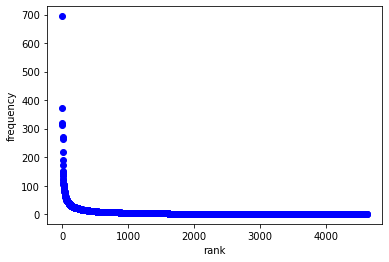

In [67]:
rank=0
for k, v in sort_dict_SW:
    rank+=1
    plt.plot(rank, words_dict_SW[k], 'bo')
plt.xlabel('rank')
plt.ylabel('frequency')
plt.show()

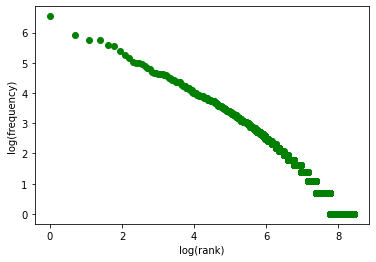

In [68]:
rank=0
for k, v in sort_dict_SW:
    rank+=1
    plt.plot(math.log(rank), math.log(v), 'go')
plt.xlabel('log(rank)')
plt.ylabel('log(frequency)')
plt.show()

In [69]:
len(text_del_SW3)

25504

In [70]:
text_freq = []
for t in text_del_SW3:
    temp=list(t)
    word_n = words_dict_SW[t[1]]
    temp.insert(4, word_n)
    text_freq.append(temp)

In [71]:
text_freq[:10]

[['Sentence: 1', '대체적', 'NNG', '100', 12],
 ['Sentence: 1', '환경', 'NNG', '100', 103],
 ['Sentence: 1', '좋', 'VA', '100', 694],
 ['Sentence: 1', '부서', 'NNG', '100', 44],
 ['Sentence: 1', '따르', 'VV', '100', 61],
 ['Sentence: 1', '다르', 'VV', '100', 54],
 ['Sentence: 1', '업무량', 'NNG', '100', 30],
 ['Sentence: 1', '몰리', 'VV', '100', 5],
 ['Sentence: 1', '야근', 'NNG', '100', 49],
 ['Sentence: 1', '필요', 'NNG', '100', 34]]

In [72]:
# 빈도수 2개 이하 삭제
text_del_words = []
for t in text_freq:
    temp=list(t)
    if t[4]>2:
        text_del_words.append(temp)

In [73]:
len(text_del_words)

21765

In [74]:
sent_n = []
for i in range(len(text_del_words)):
    sent_n.append(re.sub(r'[^0-9]', '', text_del_words[i][0]))

In [75]:
X_text=[]
y_score=[]
sent=[]
for i in range(len(sent_n)-1):
    if (int(sent_n[i]) == int(sent_n[i+1])):
        sent.append(text_del_words[i][1])
    else:
        X_text.append(sent)
        y_score.append(text_del_words[i][3])        
        sent=[]

In [76]:
X_text[:10]

[['대체적', '환경', '좋', '부서', '따르', '다르', '업무량', '몰리', '야근', '필요', '경우'],
 ['정년', '확실히', '보장', '도서', '아니', '다양', '프로그램', '운영'],
 ['대한민국', '산업', '소수', '정예', '관리', '전문', '소속', '대한민국', '전체', '명'],
 ['수평적',
  '분위기',
  '좋',
  '상사',
  '눈치',
  '많이',
  '안',
  '보고',
  '휴가',
  '내가',
  '열심히',
  '외국인',
  '일하',
  '좋아하',
  '즐기',
  '저녁',
  '삶'],
 ['민원인', '많', '강도', '높'],
 ['활동', '좋', '지원'],
 ['관하', '수행', '정책', '크'],
 ['서울', '국제', '다루', '커리어', '쌓'],
 ['자유', '분위기', '보수적', '않', '상당히', '유연', '느낌'],
 ['제대로', '지키', '전반적', '모나', '없이', '다만', '민', '원인', '상대', '어', '디', '가나']]

In [77]:
y_score[:10]

['100', '100', '100', '100', '100', '100', '100', '100', '100', '100']

In [78]:
tokenizer = Tokenizer()
X_text_token = tokenizer.fit_on_texts(X_text)

In [79]:
X_text_token

In [80]:
print(len(tokenizer.word_index))
print(tokenizer.word_index)
# 빈도수가 높은 단어 순서대로 index 부여

1608
{'좋': 1, '없': 2, '일하': 3, '많': 4, '않': 5, '분위기': 6, '다니': 7, '배우': 8, '다양': 9, '문화': 10, '복지': 11, '경험': 12, '잘': 13, '연봉': 14, '크': 15, '안': 16, '대하': 17, '받': 18, '많이': 19, '성장': 20, '환경': 21, '아니': 22, '편하': 23, '경력': 24, '쌓': 25, '급여': 26, '안정적': 27, '높': 28, '너무': 29, '자유': 30, '나쁘': 31, '발전': 32, '편': 33, '계약': 34, '추천': 35, '매우': 36, '신입': 37, '업계': 38, '공무원': 39, '시간': 40, '그냥': 41, '체계': 42, '1': 43, '힘들': 44, '대우': 45, '따르': 46, '있음': 47, '조직': 48, '위하': 49, '강도': 50, '본인': 51, '하지만': 52, '개인': 53, '자기': 54, '워': 55, '가능': 56, '괜찮': 57, '개발': 58, '금융': 59, '없이': 60, '대표': 61, '다르': 62, '보수적': 63, '최고': 64, '야근': 65, '비하': 66, '나': 67, '부서': 68, '이상': 69, '능력': 70, '공기업': 71, '커리어': 72, '보험': 73, '알': 74, '더': 75, '사무실': 76, '돈': 77, '운영': 78, '정규직': 79, '은행': 80, '하나': 81, '오래': 82, '장점': 83, '정도': 84, '월급': 85, '다른': 86, '낮': 87, '보장': 88, '수평적': 89, '별로': 90, '무난': 91, '입사': 92, '그렇': 93, '위치': 94, '회계': 95, '바뀌': 96, '사회': 97, '가능성': 98, '생활': 99, '워라밸': 100, '때문': 10

In [81]:
threshold = 2
total_cnt = len(tokenizer.word_index)
rare_cnt=0 # threshold 보다 적은 빈도의 단어 수 count
total_freq = 0
rare_freq = 0

for k, v in tokenizer.word_counts.items():
    total_freq = total_freq + v
    
    if(v < threshold):
        rare_cnt = rare_cnt + 1
        rare_freq = rare_freq + v

In [82]:
print(total_cnt)
print(rare_cnt)


1608
21


In [83]:
vocab_size = total_cnt - rare_cnt + 1
print(vocab_size)

1588


In [84]:
len(X_text)

2551

In [85]:
tokenizer = Tokenizer(vocab_size)
tokenizer.fit_on_texts(X_text)
X_text = tokenizer.texts_to_sequences(X_text)

X_train, X_test, y_train, y_test = train_test_split(X_text, y_score, test_size=0.3, random_state=111)
#X_train = tokenizer.texts_to_sequences(X_text[:200])
#X_test = tokenizer.texts_to_sequences(X_text[201:])

In [86]:
len(X_train)

1785

In [87]:
X_test[:10]

[[19, 198, 9],
 [26, 324, 50, 87, 227, 88, 824, 3, 394],
 [692, 7, 236, 31, 5, 168, 250],
 [190,
  359,
  316,
  359,
  599,
  386,
  78,
  114,
  390,
  229,
  386,
  78,
  701,
  916,
  386,
  78,
  1235,
  193,
  917,
  352],
 [156, 557, 34, 352, 917],
 [648, 222, 873, 29, 1266, 142, 532, 1047],
 [276, 298, 124, 125, 241, 1329, 22, 28, 293, 187],
 [409, 851, 486, 51, 718, 30],
 [338,
  233,
  35,
  789,
  107,
  97,
  563,
  43,
  322,
  229,
  268,
  631,
  104,
  1484,
  180,
  41,
  400],
 [156, 223, 166, 1393, 429, 275, 491, 59, 362, 528, 5, 772]]

In [88]:
y_test[:10]

['100', '100', '0', '0', '100', '0', '0', '100', '0', '100']

In [89]:
drop_train = [index for index, sentence in enumerate(X_train) if len(sentence) < 1]

In [90]:
drop_train # 비어 있는 샘플 확인

[183, 494, 1088, 1596]

In [91]:
for index in drop_train:
    del X_train[index]
    del y_train[index]
#X_train = np.delete(X_train, drop_train, axis=0)
#y_train = np.delete(y_train, drop_train, axis=0)

In [92]:
len(X_train)

1781

In [93]:
X_train

[[30, 6, 183, 1483, 2, 41, 308, 1481, 1047],
 [63, 5],
 [656, 265, 714, 1290, 822, 63, 5, 11, 320, 6],
 [173, 6, 31, 5, 14, 9],
 [1450, 59, 940, 256, 1450, 518, 78, 694, 1, 576, 1450, 22],
 [836, 1133, 1029, 1, 7],
 [1176, 46],
 [848, 834, 1028, 40, 86],
 [1293, 15, 2, 1050, 7],
 [43, 755, 494, 908, 69],
 [937, 32, 164, 96, 307, 70, 464, 420, 401],
 [78, 123, 717],
 [522, 275, 273],
 [3, 1, 347, 214, 31, 5, 8, 161, 75, 212],
 [41, 1157, 470, 776, 58, 8],
 [372, 29, 1086, 259, 1173, 124, 125, 867, 158, 158, 46, 1132],
 [1284, 1556],
 [133, 5, 14, 87, 433, 168, 84, 632, 47, 55],
 [20, 98, 2, 164, 767, 409, 454, 22, 533, 636, 1056],
 [89, 10, 110, 88, 660, 102, 197],
 [280, 705, 491, 280, 705, 574, 697, 44, 894, 450, 406, 108, 22, 409],
 [23, 6, 19],
 [255, 741, 984, 295, 427, 226],
 [1, 6, 65, 364],
 [37, 94, 7, 44, 4, 302, 12, 20, 47, 37, 32, 133],
 [3, 23, 679, 176, 56, 370, 264, 435],
 [63, 466, 48, 28, 118, 14, 27, 20, 203],
 [442, 1, 71, 23, 1286, 40, 569, 40],
 [53,
  569,
  718,
 

리뷰의 최대 길이 : 136
리뷰의 평균 길이 : 7.523862998315553


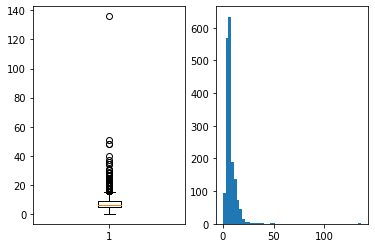

In [94]:
len_result = [len(s) for s in X_train]

print('리뷰의 최대 길이 : {}'.format(np.max(len_result)))
print('리뷰의 평균 길이 : {}'.format(np.mean(len_result)))

plt.subplot(1,2,1)
plt.boxplot(len_result)
plt.subplot(1,2,2)
plt.hist(len_result, bins=50)
plt.show()

In [95]:
max_len=20

In [96]:
def below_threshold_len(max_len, nested_list):
    count = 0
    for sentence in nested_list:
        if(len(sentence) <= max_len):
            count = count + 1
    print('전체 샘플 중 길이가 %s 이하인 샘플의 비율: %s'%(max_len, (count / len(nested_list))*100))

In [97]:
below_threshold_len(max_len, X_train)

전체 샘플 중 길이가 20 이하인 샘플의 비율: 98.03481190342505


In [98]:
unique_elements, counts_elements = np.unique(y_train, return_counts=True)
print("각 레이블에 대한 빈도수:")
print(np.asarray((unique_elements, counts_elements)))

각 레이블에 대한 빈도수:
[['0' '100']
 ['899' '882']]


In [99]:
word_to_index = tokenizer.word_index
index_to_word = {}
for key, value in word_to_index.items():
    index_to_word[value+3] = key

In [100]:
print('빈도수 상위 1등 단어 : {}'.format(index_to_word[4]))

빈도수 상위 1등 단어 : 좋


In [101]:
# (index 변환 전) X_train[0] 한국어 단어 표시
for index, token in enumerate(("<pad>", "<sos>", "<unk>")):
    index_to_word[index] = token

print(' '.join([index_to_word[index] for index in X_train[0]]))

안정적 일하 만들 실무진 <unk> 업계 시장 죽 휴직


In [102]:
X_train = np.array(X_train)
y_train = np.array(y_train)
X_test = np.array(X_test)
y_test = np.array(y_test)

In [103]:
X_train = pad_sequences(X_train, maxlen=max_len)
X_test = pad_sequences(X_test, maxlen=max_len)

In [104]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(1781, 20)
(1781,)
(766, 20)
(766,)


In [105]:
# Naive bayes training
nb = MultinomialNB()
nb.fit(X_train, y_train)
preds = nb.predict(X_test)
print(confusion_matrix(y_test, preds))
print('\n')
print(classification_report(y_test, preds))

[[292 103]
 [291  80]]


              precision    recall  f1-score   support

           0       0.50      0.74      0.60       395
         100       0.44      0.22      0.29       371

    accuracy                           0.49       766
   macro avg       0.47      0.48      0.44       766
weighted avg       0.47      0.49      0.45       766



In [106]:
# Logistic Regression training

logreg = LogisticRegression(solver='liblinear')
logreg.fit(X_train, y_train)
# Logistic Regression prediction
y_pred_logreg = logreg.predict(X_test)
print(classification_report(y_test, y_pred_logreg))

              precision    recall  f1-score   support

           0       0.50      0.54      0.52       395
         100       0.46      0.41      0.43       371

    accuracy                           0.48       766
   macro avg       0.48      0.48      0.48       766
weighted avg       0.48      0.48      0.48       766



In [107]:
svc = SVC(gamma='scale', kernel='linear')
svc.fit(X_train, y_train)
y_pred_svc = svc.predict(X_test)
print(classification_report(y_test, y_pred_svc))

              precision    recall  f1-score   support

           0       0.50      0.85      0.63       395
         100       0.37      0.10      0.15       371

    accuracy                           0.48       766
   macro avg       0.44      0.47      0.39       766
weighted avg       0.44      0.48      0.40       766



In [121]:
# ANN
ANN = MLPClassifier(solver='lbfgs', alpha=1, hidden_layer_sizes=(20, 2), random_state=3)
ANN.fit(X_train, y_train)
y_pred_ANN = ANN.predict(X_test)
print(classification_report(y_test, y_pred_ANN))

c:\users\sj\appdata\local\programs\python\python39\lib\site-packages\ipykernel\ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


              precision    recall  f1-score   support

           0       0.52      1.00      0.68       395
         100       0.67      0.01      0.01       371

    accuracy                           0.52       766
   macro avg       0.59      0.50      0.35       766
weighted avg       0.59      0.52      0.36       766



In [116]:
# k-Nearest Neighbor
knn  = KNeighborsClassifier(n_neighbors = 3)
knn.fit(X_train, y_train)
y_pred_knn = knn.predict(X_test)
print(classification_report(y_test, y_pred_knn))

              precision    recall  f1-score   support

           0       0.55      0.55      0.55       395
         100       0.52      0.51      0.52       371

    accuracy                           0.53       766
   macro avg       0.53      0.53      0.53       766
weighted avg       0.53      0.53      0.53       766



In [115]:
# Decision Tree
decision_tree = DecisionTreeClassifier()
decision_tree.fit(X_train, y_train)
y_pred_DT = decision_tree.predict(X_test)
print(classification_report(y_test, y_pred_DT))

              precision    recall  f1-score   support

           0       0.54      0.53      0.53       395
         100       0.51      0.53      0.52       371

    accuracy                           0.53       766
   macro avg       0.53      0.53      0.53       766
weighted avg       0.53      0.53      0.53       766



In [124]:
# 평균값을 기준으로 나눔. 100/0 이분
# 53.x 55점 50점
# + 점수별 리뷰 수 -> 평균값 주변에 리뷰 수가 몰려 있으면 분류가 어려움

c:\users\sj\appdata\local\programs\python\python39\lib\site-packages\ipykernel\ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
